In [1]:
# -*- coding: utf-8 -*-
#  File: otus_pro_hw3.ipynb
#  Project: 'OTUS PRO Homework #3'
#  Created by Gennady Matveev (gm@og.ly) on 17-01-2022.
#  Attributions: This notebook is in large part based on
#  the code provided in lesson #10 OTUS.ML.Pro, adopted 
#  to "Credit Card Fraud Detection" dataset

![OTUS.ML.Pro](https://docs.google.com/uc?export=download&id=1WNdJ3EbDWli0UARUhWLwGmC5_RUuIJ7n)
<!-- https://drive.google.com/file/d/1WNdJ3EbDWli0UARUhWLwGmC5_RUuIJ7n/view?usp=sharing -->

# **$Homework$** **$3$**
**OTUS Machine Learning Professional**

# Anomaly detection

Goals:   
- Apply **anomaly detection** methods to "Credit Card Fraud Detection" dataset
- Carry out basic EDA
- Use anomaly percentage, calculated by "Class" variable, as an "expert estimate" of the dataset "impurity"
- Estimate the quality of models with their predictions and "Class" variable, using classificationrt and confusion matrix
- Check if anomalies are separated from the rest of data with UMAP/t-sne.

Additional goals:  
- Try outlier detection methods from ATOM library (separate notebook)
- Look into PyOD possibilities (separate notebook)
- Apply voting classifier (here and in PyOD)

Means:  
- All meaningful programming will be done in sklearn

Dataset:
- Credit Card Fraud Detection 
https://www.kaggle.com/mlg-ulb/creditcardfraud#creditcard.csv

Abbreviations:
- EDA: exploratory data analysis
- PP: preprocessing
- AD: anomaly detection

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Google-colab-specific-part" data-toc-modified-id="Google-colab-specific-part-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Google colab specific part</a></span></li><li><span><a href="#Import-libraries-and-setup-notebook" data-toc-modified-id="Import-libraries-and-setup-notebook-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Import libraries and setup notebook</a></span><ul class="toc-item"><li><span><a href="#Miscellaneous-settings" data-toc-modified-id="Miscellaneous-settings-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Miscellaneous settings</a></span></li><li><span><a href="#ML-parameters" data-toc-modified-id="ML-parameters-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>ML parameters</a></span></li><li><span><a href="#Load-data" data-toc-modified-id="Load-data-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Load data</a></span></li><li><span><a href="#Choose-full-or-partial-data" data-toc-modified-id="Choose-full-or-partial-data-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Choose full or partial data</a></span></li></ul></li><li><span><a href="#Dataset-contamination" data-toc-modified-id="Dataset-contamination-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Dataset contamination</a></span></li><li><span><a href="#EDA" data-toc-modified-id="EDA-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>EDA</a></span><ul class="toc-item"><li><span><a href="#Histograms" data-toc-modified-id="Histograms-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Histograms</a></span></li><li><span><a href="#Correlations" data-toc-modified-id="Correlations-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Correlations</a></span></li><li><span><a href="#Highly-correlated-features" data-toc-modified-id="Highly-correlated-features-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Highly correlated features</a></span></li><li><span><a href="#Pairplots-of-some-other-features" data-toc-modified-id="Pairplots-of-some-other-features-4.4"><span class="toc-item-num">4.4&nbsp;&nbsp;</span>Pairplots of some other features</a></span></li></ul></li><li><span><a href="#Quality-check-function" data-toc-modified-id="Quality-check-function-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Quality check function</a></span></li><li><span><a href="#Simple-methods" data-toc-modified-id="Simple-methods-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Simple methods</a></span><ul class="toc-item"><li><span><a href="#Scale-the-data" data-toc-modified-id="Scale-the-data-6.1"><span class="toc-item-num">6.1&nbsp;&nbsp;</span>Scale the data</a></span></li><li><span><a href="#Distribution-of-distances" data-toc-modified-id="Distribution-of-distances-6.2"><span class="toc-item-num">6.2&nbsp;&nbsp;</span>Distribution of distances</a></span></li><li><span><a href="#Utility-finctions" data-toc-modified-id="Utility-finctions-6.3"><span class="toc-item-num">6.3&nbsp;&nbsp;</span>Utility finctions</a></span></li><li><span><a href="#Distance-based" data-toc-modified-id="Distance-based-6.4"><span class="toc-item-num">6.4&nbsp;&nbsp;</span>Distance-based</a></span><ul class="toc-item"><li><span><a href="#STD---three-(or-even-ten)-sigmas" data-toc-modified-id="STD---three-(or-even-ten)-sigmas-6.4.1"><span class="toc-item-num">6.4.1&nbsp;&nbsp;</span>STD - three (or even ten) sigmas</a></span><ul class="toc-item"><li><span><a href="#Quality-check---STD-(&quot;3-sigmas&quot;)" data-toc-modified-id="Quality-check---STD-(&quot;3-sigmas&quot;)-6.4.1.1"><span class="toc-item-num">6.4.1.1&nbsp;&nbsp;</span>Quality check - STD ("3 sigmas")</a></span></li></ul></li><li><span><a href="#Interquartile-range" data-toc-modified-id="Interquartile-range-6.4.2"><span class="toc-item-num">6.4.2&nbsp;&nbsp;</span>Interquartile range</a></span><ul class="toc-item"><li><span><a href="#Quality-check---IQR" data-toc-modified-id="Quality-check---IQR-6.4.2.1"><span class="toc-item-num">6.4.2.1&nbsp;&nbsp;</span>Quality check - IQR</a></span></li></ul></li><li><span><a href="#Clustering" data-toc-modified-id="Clustering-6.4.3"><span class="toc-item-num">6.4.3&nbsp;&nbsp;</span>Clustering</a></span><ul class="toc-item"><li><span><a href="#Euclidean-distance" data-toc-modified-id="Euclidean-distance-6.4.3.1"><span class="toc-item-num">6.4.3.1&nbsp;&nbsp;</span>Euclidean distance</a></span></li><li><span><a href="#Cityblock-distance" data-toc-modified-id="Cityblock-distance-6.4.3.2"><span class="toc-item-num">6.4.3.2&nbsp;&nbsp;</span>Cityblock distance</a></span></li></ul></li></ul></li><li><span><a href="#Density-based" data-toc-modified-id="Density-based-6.5"><span class="toc-item-num">6.5&nbsp;&nbsp;</span>Density-based</a></span><ul class="toc-item"><li><span><a href="#DBSCAN" data-toc-modified-id="DBSCAN-6.5.1"><span class="toc-item-num">6.5.1&nbsp;&nbsp;</span>DBSCAN</a></span><ul class="toc-item"><li><span><a href="#Quality-check---DBSCAN" data-toc-modified-id="Quality-check---DBSCAN-6.5.1.1"><span class="toc-item-num">6.5.1.1&nbsp;&nbsp;</span>Quality check - DBSCAN</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#Unsupervised-model-based" data-toc-modified-id="Unsupervised-model-based-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Unsupervised model-based</a></span><ul class="toc-item"><li><span><a href="#One-Class-SVM" data-toc-modified-id="One-Class-SVM-7.1"><span class="toc-item-num">7.1&nbsp;&nbsp;</span>One-Class SVM</a></span><ul class="toc-item"><li><span><a href="#Quality-check---OneClassSVM" data-toc-modified-id="Quality-check---OneClassSVM-7.1.1"><span class="toc-item-num">7.1.1&nbsp;&nbsp;</span>Quality check - OneClassSVM</a></span></li></ul></li><li><span><a href="#Isolation-Forest" data-toc-modified-id="Isolation-Forest-7.2"><span class="toc-item-num">7.2&nbsp;&nbsp;</span>Isolation Forest</a></span><ul class="toc-item"><li><span><a href="#Quality-check---iForest" data-toc-modified-id="Quality-check---iForest-7.2.1"><span class="toc-item-num">7.2.1&nbsp;&nbsp;</span>Quality check - iForest</a></span></li></ul></li></ul></li><li><span><a href="#Methods-comparison" data-toc-modified-id="Methods-comparison-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Methods comparison</a></span><ul class="toc-item"><li><span><a href="#All-combined-(average-score)" data-toc-modified-id="All-combined-(average-score)-8.1"><span class="toc-item-num">8.1&nbsp;&nbsp;</span>All combined (average score)</a></span><ul class="toc-item"><li><span><a href="#Quality-check---all-models-average" data-toc-modified-id="Quality-check---all-models-average-8.1.1"><span class="toc-item-num">8.1.1&nbsp;&nbsp;</span>Quality check - all models average</a></span></li></ul></li><li><span><a href="#Only-model-based" data-toc-modified-id="Only-model-based-8.2"><span class="toc-item-num">8.2&nbsp;&nbsp;</span>Only model-based</a></span><ul class="toc-item"><li><span><a href="#Quality-check---model-based" data-toc-modified-id="Quality-check---model-based-8.2.1"><span class="toc-item-num">8.2.1&nbsp;&nbsp;</span>Quality check - model-based</a></span></li></ul></li></ul></li><li><span><a href="#Comparison-of-results---classification-reports" data-toc-modified-id="Comparison-of-results---classification-reports-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Comparison of results - classification reports</a></span></li></ul></div>

<a href="https://colab.research.google.com/github/oort77/OTUS_PRO_HW3/blob/main/notebooks/otus_pro_hw3_sklearn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a> 

## Google colab specific part

Please uncomment and run the cell below to install dependencies.  Restart of runtime is required after installation.
Typical runtime on colab with 20% of data is around 30 minutes (to include installation of libraries ~ 2-3 minutes).

In [2]:
# !pip install -r "https://drive.google.com/uc?export=download&id=14TOXCFVR7VPnfNiKimcz-BUUaJastb4h"

## Import libraries and setup notebook

In [3]:
import numpy as np
import pandas as pd

from sklearn.cluster import DBSCAN
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import  \
        StandardScaler, MinMaxScaler, RobustScaler
from sklearn.model_selection import RandomizedSearchCV
from sklearn.base import BaseEstimator

from imblearn.combine import SMOTEENN

import scipy.stats as stats
from scipy.spatial.distance import cdist
from scipy.spatial.distance import pdist

from umap import UMAP
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import plotly.express as px

import re
import gdown
import random
import pickle
import os.path
import pickle
import warnings
from collections import Counter
from IPython.core.display import display, HTML

### Miscellaneous settings 

In [4]:
%matplotlib inline
display(HTML("<style>.container {width:80% !important; }</style>"))
plt.rcParams["figure.figsize"] = (12, 4)
plt.style.use('seaborn')
sns.set(rc={'figure.figsize': (12, 4)})
warnings.filterwarnings("ignore")
pd.options.display.precision = 4
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

### ML parameters

In [5]:
random_state = 17
random.seed(random_state)
n_jobs = 2 # <-- for colab
# n_jobs = -1 # for local runs

### Load data

In [6]:
# Local file
# data = pd.read_csv("../data/archive.zip", compression="zip")

#From Google Drive
!mkdir ../data
url = "https://drive.google.com/uc?id=1Na6k8qB2aIoHQJeXAnCQXG6gDb6W6MtS"
data = pd.read_csv(gdown.download(
    url, output="../data/archive.zip", quiet=True), compression="zip")

# Through away "Time" column
data = data.astype("float32").iloc[:, 1:]
# Save for later
with open("./data/data.pickle","wb") as f:
    pickle.dump(data, f, pickle.HIGHEST_PROTOCOL)
data.head()

mkdir: cannot create directory ‘../data’: File exists


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.3598,-0.0728,2.5363,1.3782,-0.3383,0.4624,0.2396,0.0987,0.3638,0.0908,-0.5516,-0.6178,-0.9914,-0.3112,1.4682,-0.4704,0.2080,0.0258,0.4040,0.2514,-0.0183,0.2778,-0.1105,0.0669,0.1285,-0.1891,0.1336,-0.0211,149.62,0.0
1,1.1919,0.2662,0.1665,0.4482,0.0600,-0.0824,-0.0788,0.0851,-0.2554,-0.1670,1.6127,1.0652,0.4891,-0.1438,0.6356,0.4639,-0.1148,-0.1834,-0.1458,-0.0691,-0.2258,-0.6387,0.1013,-0.3398,0.1672,0.1259,-0.0090,0.0147,2.69,0.0
2,-1.3584,-1.3402,1.7732,0.3798,-0.5032,1.8005,0.7915,0.2477,-1.5147,0.2076,0.6245,0.0661,0.7173,-0.1659,2.3459,-2.8901,1.1100,-0.1214,-2.2619,0.5250,0.2480,0.7717,0.9094,-0.6893,-0.3276,-0.1391,-0.0554,-0.0598,378.66,0.0
3,-0.9663,-0.1852,1.7930,-0.8633,-0.0103,1.2472,0.2376,0.3774,-1.3870,-0.0550,-0.2265,0.1782,0.5078,-0.2879,-0.6314,-1.0596,-0.6841,1.9658,-1.2326,-0.2080,-0.1083,0.0053,-0.1903,-1.1756,0.6474,-0.2219,0.0627,0.0615,123.50,0.0
4,-1.1582,0.8777,1.5487,0.4030,-0.4072,0.0959,0.5929,-0.2705,0.8177,0.7531,-0.8228,0.5382,1.3459,-1.1197,0.1751,-0.4514,-0.2370,-0.0382,0.8035,0.4085,-0.0094,0.7983,-0.1375,0.1413,-0.2060,0.5023,0.2194,0.2152,69.99,0.0


In [7]:
X, y = data.iloc[:, :-1], data.iloc[:, -1]

## Dataset contamination

In [8]:
y.value_counts(normalize=True)

0.0    0.9983
1.0    0.0017
Name: Class, dtype: float64

<div class="alert alert-block alert-success">
<b>"Class"</b> column contains 492 fraud values, only 0.17% of the whole dataset. We will use this number as an "expert estimate".
</div>

## Balance classes with SMOTEENN

Let's improve class 1 representation in the dataset from 0.17% to 1%

In [9]:
print(f"Original dataset shape {Counter(y)}")

if os.path.exists("../data/data_res.pickle"):
    with open("../data/data_res.pickle", "rb") as f:
        data = pickle.load(f)
else:
    sme = SMOTEENN(sampling_strategy=0.01, random_state=random_state, n_jobs=n_jobs)
    X_res, y_res = sme.fit_resample(X, y)
    data = pd.concat([X_res, y_res], axis = 1)
    print(f"Resampled dataset shape {Counter(y_res)}")

data.head()

Original dataset shape Counter({0.0: 284315, 1.0: 492})
Resampled dataset shape Counter({0.0: 284020, 1.0: 2629})


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.3598,-0.0728,2.5363,1.3782,-0.3383,0.4624,0.2396,0.0987,0.3638,0.0908,-0.5516,-0.6178,-0.9914,-0.3112,1.4682,-0.4704,0.2080,0.0258,0.4040,0.2514,-0.0183,0.2778,-0.1105,0.0669,0.1285,-0.1891,0.1336,-0.0211,149.62,0.0
1,1.1919,0.2662,0.1665,0.4482,0.0600,-0.0824,-0.0788,0.0851,-0.2554,-0.1670,1.6127,1.0652,0.4891,-0.1438,0.6356,0.4639,-0.1148,-0.1834,-0.1458,-0.0691,-0.2258,-0.6387,0.1013,-0.3398,0.1672,0.1259,-0.0090,0.0147,2.69,0.0
2,-1.3584,-1.3402,1.7732,0.3798,-0.5032,1.8005,0.7915,0.2477,-1.5147,0.2076,0.6245,0.0661,0.7173,-0.1659,2.3459,-2.8901,1.1100,-0.1214,-2.2619,0.5250,0.2480,0.7717,0.9094,-0.6893,-0.3276,-0.1391,-0.0554,-0.0598,378.66,0.0
3,-0.9663,-0.1852,1.7930,-0.8633,-0.0103,1.2472,0.2376,0.3774,-1.3870,-0.0550,-0.2265,0.1782,0.5078,-0.2879,-0.6314,-1.0596,-0.6841,1.9658,-1.2326,-0.2080,-0.1083,0.0053,-0.1903,-1.1756,0.6474,-0.2219,0.0627,0.0615,123.50,0.0
4,-1.1582,0.8777,1.5487,0.4030,-0.4072,0.0959,0.5929,-0.2705,0.8177,0.7531,-0.8228,0.5382,1.3459,-1.1197,0.1751,-0.4514,-0.2370,-0.0382,0.8035,0.4085,-0.0094,0.7983,-0.1375,0.1413,-0.2060,0.5023,0.2194,0.2152,69.99,0.0


In [10]:
with open("../data/data_res.pickle","wb") as f:
    pickle.dump(data, f, pickle.HIGHEST_PROTOCOL)

mkdir: cannot create directory ‘../data/’: File exists


<div class="alert alert-block alert-success">
Now <b>"Class"</b> column contains 2828 fraud values, about 1% of the whole dataset. We will use this number as an "expert estimate".
</div>

### Choose full or partial data

In [11]:
rand_part = 0.2  # for testing of computationally expensive parts
partial = 0
# Randomly select rand_part of rows
part = sorted(random.choices(
    range(data.shape[0]), k=int(data.shape[0]*rand_part)))
if partial == 0:
    X, y = data.iloc[:, :-1], data.iloc[:, -1]
else:
    X, y = data.iloc[part, :-1], data.iloc[part, -1]
    data = data.iloc[part]
    
data.reset_index(drop=True, inplace=True)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.25, stratify=y, random_state=random_state)

## EDA

In [12]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
V1,286649.0,-0.0375,2.0899,-56.4075,-0.9324,0.0067,1.3121,2.4549
V2,286649.0,0.0307,1.7200,-72.7157,-0.5928,0.0731,0.8185,22.0577
V3,286649.0,-0.0556,1.7615,-48.3256,-0.9164,0.1698,1.0211,9.3826
V4,286649.0,0.0334,1.4846,-5.6832,-0.8424,-0.0079,0.7659,16.8753
V5,286649.0,-0.0266,1.4809,-113.7433,-0.7016,-0.0590,0.6095,34.8017
V6,286649.0,-0.0107,1.3413,-26.1605,-0.7755,-0.2793,0.3930,73.3016
V7,286649.0,-0.0455,1.4733,-43.5572,-0.5653,0.0345,0.5661,120.5895
V8,286649.0,0.0058,1.3360,-73.2167,-0.2081,0.0239,0.3324,20.0072
V9,286649.0,-0.0199,1.1381,-13.4341,-0.6554,-0.0564,0.5920,15.5950
V10,286649.0,-0.0445,1.2690,-24.5883,-0.5456,-0.0979,0.4473,23.7451


### Histograms

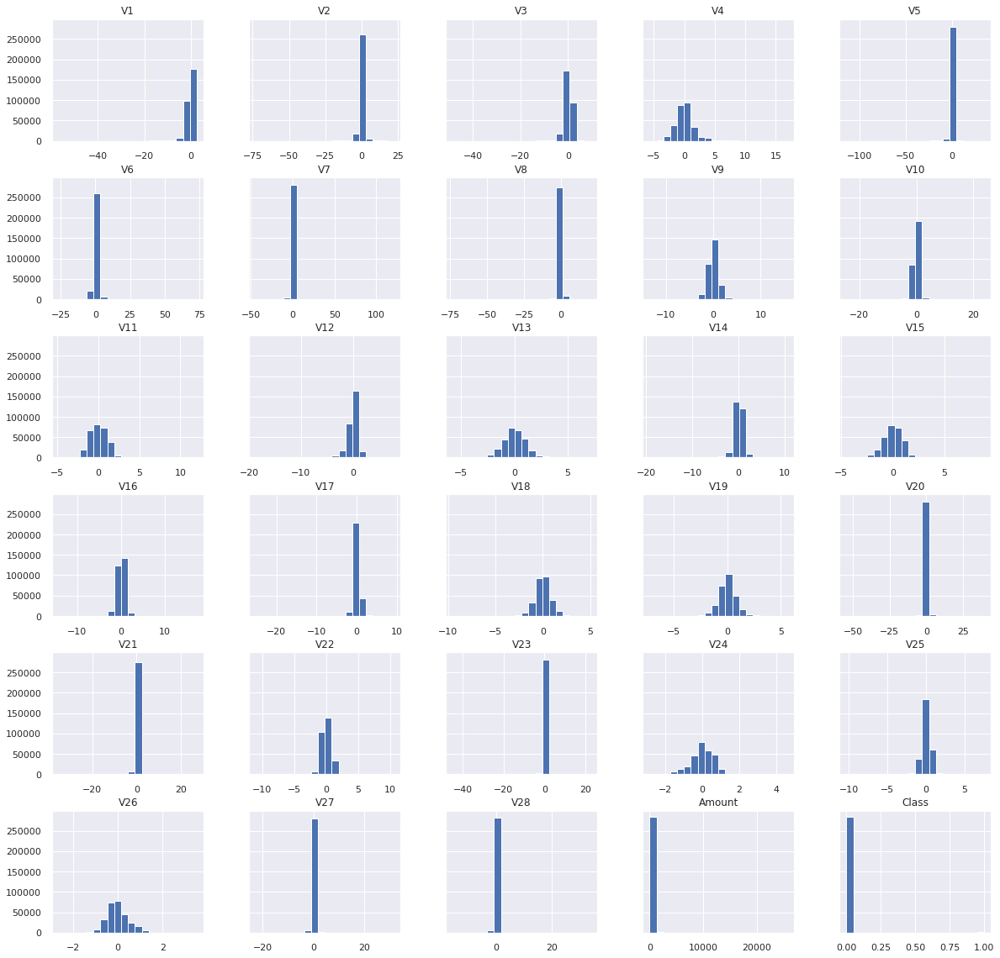

In [13]:
_ = data.hist(bins=20, sharey=True, figsize=(20, 20))

### Correlations

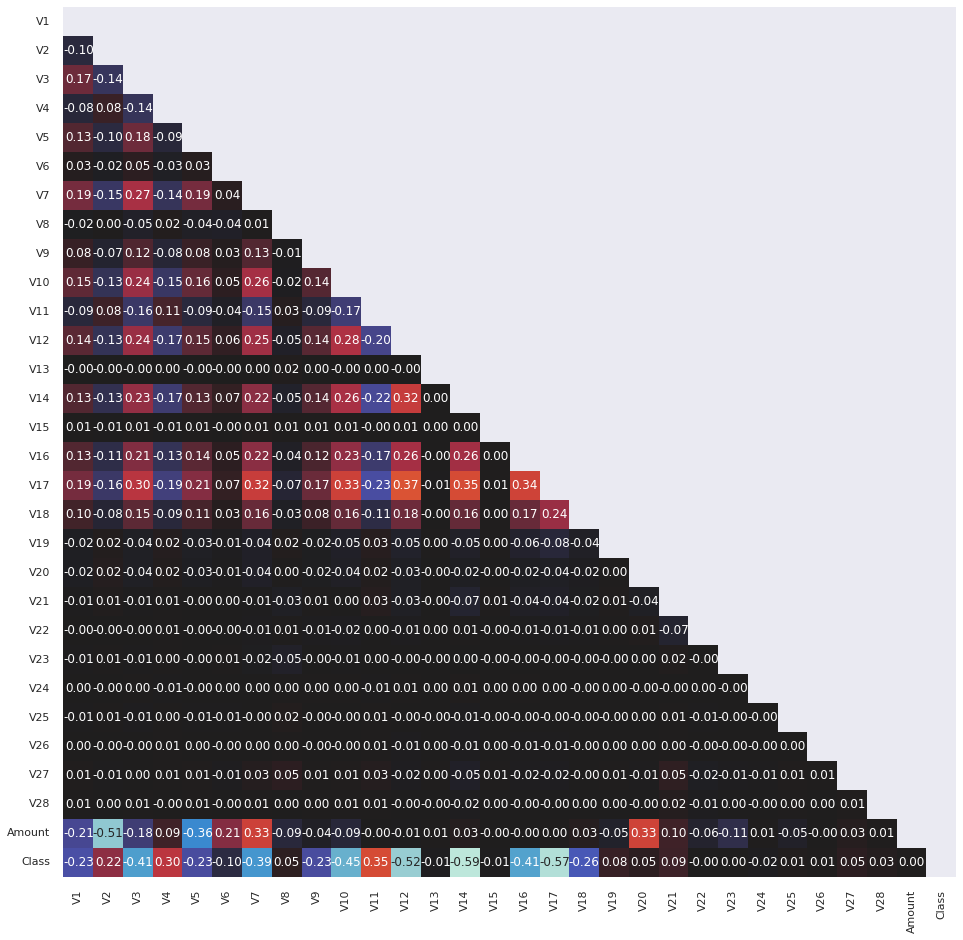

In [14]:
plt.figure(figsize=(16, 16))

corr_matrix = data.corr()
lower = corr_matrix.where(
    np.tril(np.ones(corr_matrix.shape), k=-1).astype(bool))

_ = sns.heatmap(lower, annot=True, fmt='.2f', cbar=False, center=0)

### Highly correlated features

In [15]:
high_corr = [
    column for column in lower.columns if any((lower[column] > 0.6) | (lower[column] < -0.4))
]
print(f" Highly correlated features: {high_corr}")

 Highly correlated features: ['V2', 'V3', 'V10', 'V12', 'V14', 'V16', 'V17']


All high correlations occur with the "Class" variable, can not drop the features.

In [16]:
other_features = [
    col for col in data.columns if col not in high_corr and col != 'show'] # ???

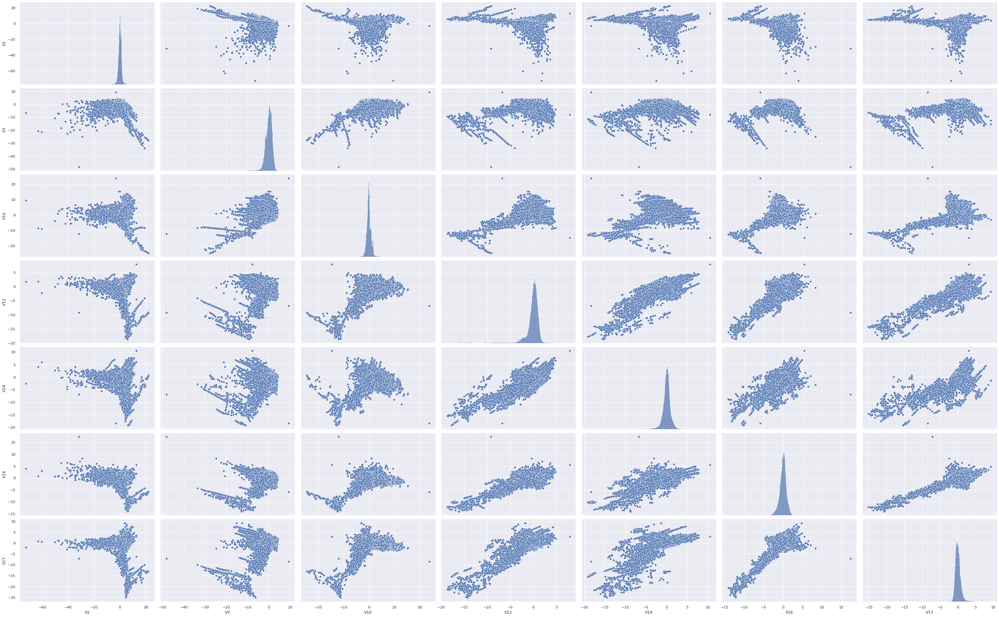

In [17]:
_ = sns.pairplot(data[high_corr], height=3.8, aspect=1.62)

### Pairplots of some other features

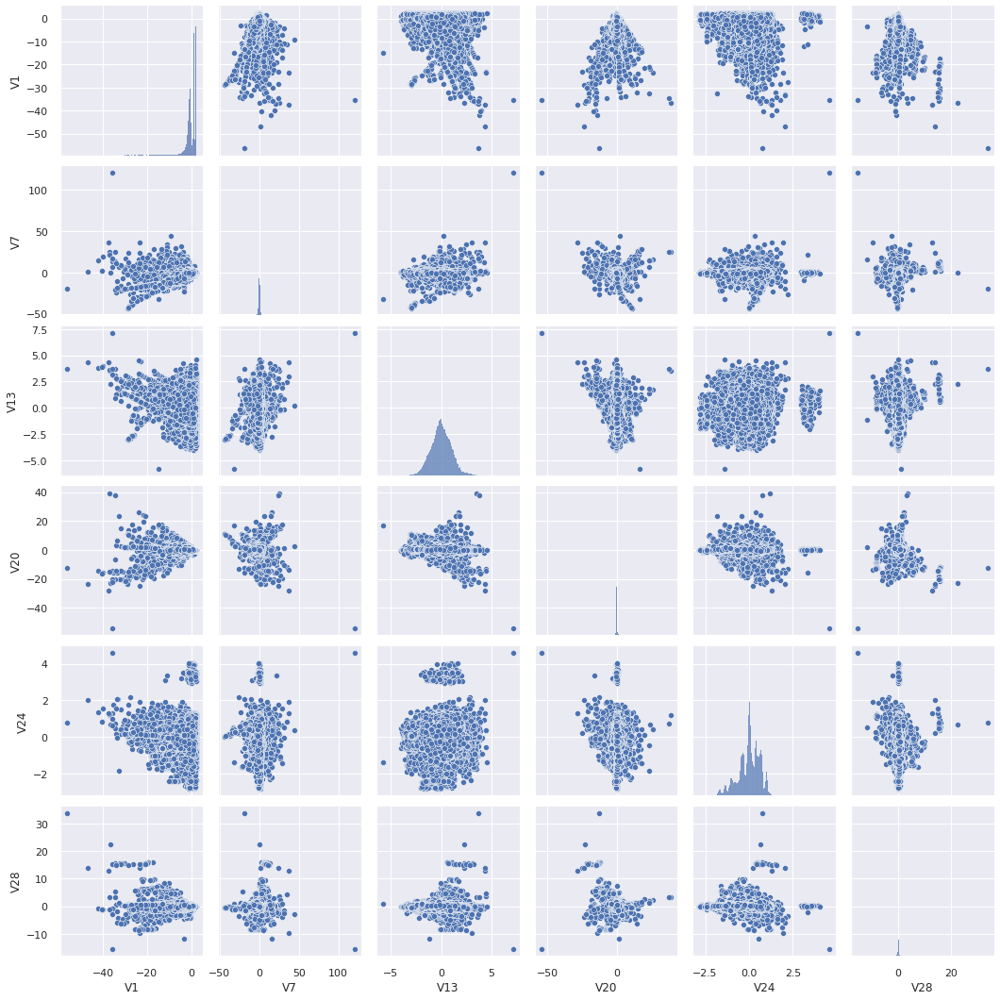

In [18]:
_ = sns.pairplot(data[other_features[::4]])


## Simple methods

### Scale the data

In [19]:
data["Amount"] = np.log1p(data["Amount"])

In [20]:
data_features = data.iloc[:, :-1]
# scaler = RobustScaler()
scaler = StandardScaler()
scaled_data = pd.DataFrame(
    data=scaler.fit_transform(data_features),
    columns=data_features.columns
)
scaled_data.shape

(286649, 29)

### Distribution of distances

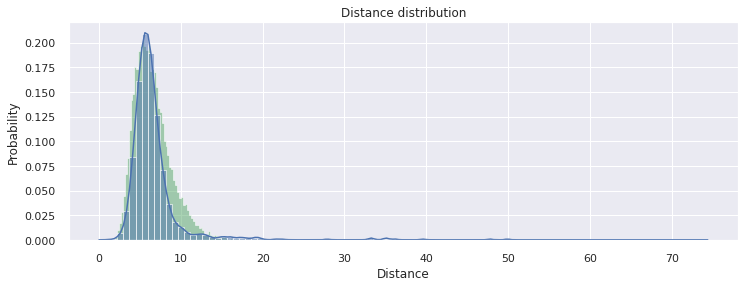

In [21]:
distr = pdist(scaled_data.loc[::100])
le = scaled_data.loc[::100].shape[0]

fig, ax = plt.subplots()
plt.setp(ax, xlabel="Distance")
logn_params = stats.lognorm.fit(distr, loc=6)
rv = stats.lognorm(*logn_params)
x = np.linspace(0,50,100)
rv_pdf = stats.lognorm.pdf(x,*logn_params)
r = stats.lognorm.rvs(*logn_params, 30000)
plt.hist(r, bins=100, color="g", density=True, histtype='stepfilled', alpha=0.5)

plt.setp(ax, title="Distance distribution")
_ = sns.histplot(data=distr, stat="probability", color='b', bins=100, kde=True)
plt.show()

What are the IQR and standard deviation for distances?

In [22]:
dist_IQR = np.quantile(distr, 0.75) - np.quantile(distr, 0.25)
dist_std = np.std(distr)
print(f"Distances IQR: {dist_IQR:.2f}, STD: {dist_std:.2f}")

Distances IQR: 1.97, STD: 3.58


<div class="alert alert-block alert-success">
<b>"Long tail: "</b>Most distances are below 10, but the tail values go well beyond 60.  
    Lognorm distribution (green) is a reasinably good fit, and it has a heavy right tail.
</div>

### Utility functions

In [23]:
# Collect confusion matrices
crs = []
def quality_check(y_true, yhat, name):
    print("Confusion matrix:\n")
    cm = confusion_matrix(y_true, yhat)#, normalize="all")
    print(cm)
    disp = ConfusionMatrixDisplay(cm)#.from_predictions
    disp.plot()
    plt.show()
    print("\n-----------------------------------------------------")
    print("\nClassification report:\n")
    cr = classification_report(y_true, yhat)
    print(cr)
    crs.append({name: cr})

In [24]:
def pairplot_with_ouliers(data, color_data, title):
    labeled_data = data.copy()
    labeled_data['is_outlier'] = color_data.copy()
    cols = ['V1', 'V6', 'V11', 'V26', 'Amount']
    featured_columns = cols.copy()
    cols.append('is_outlier')

    _ = sns.pairplot(data=labeled_data[cols],
                     vars=featured_columns, hue='is_outlier',
                     hue_order=[1, 0], markers=['X', 'o'],
                     palette='bright')
    plt.suptitle(title, y=1.02, fontsize=20)

In [25]:
def visualize_2d(data, color_data, title):
    features = data.copy()
    n_features = features.shape[1]

    # UMAP-transform feature space
    umap = UMAP(n_components=2, init='random',
                n_jobs=n_jobs, random_state=random_state)
    proj = umap.fit_transform(features)

    fig = px.scatter(
        proj, x=0, y=1,
        color=color_data.astype("str"),
        labels={'color': 'Outliers'},
        title=title,
        width=720, height=480,
        template="seaborn",  # "plotly_dark",
        color_discrete_sequence=px.colors.qualitative.Dark24
    )
    fig.update_traces(marker_size=5)
    fig.show()

In [26]:
def visualize_3d(data, color_data, title):
    features = data.copy()
    n_features = features.shape[1]
    
    # UMAP
    umap_3d = UMAP(n_components=3, init='random',
                   random_state=random_state)
    proj_3d = umap_3d.fit_transform(features)

    fig_3d = px.scatter_3d(
        proj_3d, x=0, y=1, z=2,
        color=color_data.astype("str"), 
        labels={'color': 'clusters'},
        title=title,
        width=720, height=480,
        template="plotly_dark"
    )
    fig_3d.update_traces(marker_size=5)
    fig_3d.show()

### Distance-based

#### STD - three (or even ten) sigmas

<div class="alert alert-block alert-success">
<b>How far are the outliers ?</b> STD values from 5 to 15 seems to be a reasonable choice for the case of fat tailed distributions that we have in this dataset. Experiments show that in this case 7.4 gives the highest F1 score.
</div>

In [27]:
threshold_std = 7.4

In [28]:
def outlier_std(data, col, threshold=threshold_std):
    mean = data[col].mean()
    std = data[col].std()
    up_bound = mean + threshold * std
    low_bound = mean - threshold * std
    anomalies = pd.concat(
        [data[col] > up_bound, data[col] < low_bound], axis=1).any(1)
    return anomalies, up_bound, low_bound

In [29]:
def get_column_outliers(data, columns=None, function=outlier_std, threshold=threshold_std):
    if columns:
        columns_to_check = columns
    else:
        columns_to_check = data.columns

    outliers = pd.Series(data=[False]*len(data),
                         index=data_features.index, name='is_outlier')
    comparison_table = {}
    for column in columns_to_check:
        anomalies, upper_bound, lower_bound = function(
            data, column, threshold=threshold)
        comparison_table[column] = [upper_bound, lower_bound,
                                    sum(anomalies), 100*sum(anomalies)/len(anomalies)]
        outliers[anomalies[anomalies].index] = True

    comparison_table = pd.DataFrame(comparison_table).T
    comparison_table.columns = [
        'upper_bound', 'lower_bound', 'anomalies_count', 'anomalies_percentage']
    comparison_table = comparison_table.sort_values(
        by='anomalies_percentage', ascending=False)

    return comparison_table, outliers


def anomalies_report(outliers):
    print(f"Total number of outliers: {sum(outliers)}\nPercentage of outliers:   {100*sum(outliers)/len(outliers):.2f}%")

In [30]:
data_features.reset_index(drop=True, inplace=True)
comparison_table, std_outliers = get_column_outliers(data_features, threshold=threshold_std)
anomalies_report(std_outliers)

Total number of outliers: 4151
Percentage of outliers:   1.45%


##### Quality check - STD ("3 sigmas")

Confusion matrix:

[[281198   2822]
 [  1300   1329]]


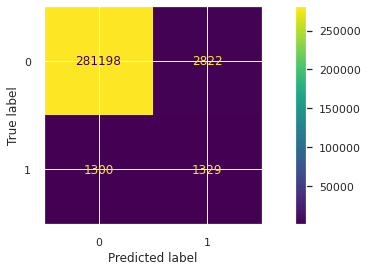


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.99      0.99    284020
         1.0       0.32      0.51      0.39      2629

    accuracy                           0.99    286649
   macro avg       0.66      0.75      0.69    286649
weighted avg       0.99      0.99      0.99    286649



In [31]:
quality_check(data["Class"], std_outliers, name="std")

In [32]:
comparison_table

,upper_bound,lower_bound,anomalies_count,anomalies_percentage
V17,8.7393,-8.8450,1005.0,0.3506
V8,9.8921,-9.8805,862.0,0.3007
V14,8.7791,-8.8871,850.0,0.2965
V21,6.0122,-6.0008,837.0,0.2920
V7,10.8567,-10.9477,783.0,0.2732
V10,9.3461,-9.4351,740.0,0.2582
V27,3.1097,-3.1066,723.0,0.2522
V23,4.6445,-4.6440,696.0,0.2428
V20,5.7392,-5.7339,677.0,0.2362
V12,8.8743,-8.9716,661.0,0.2306


Too many features for pairplot, show only five columns

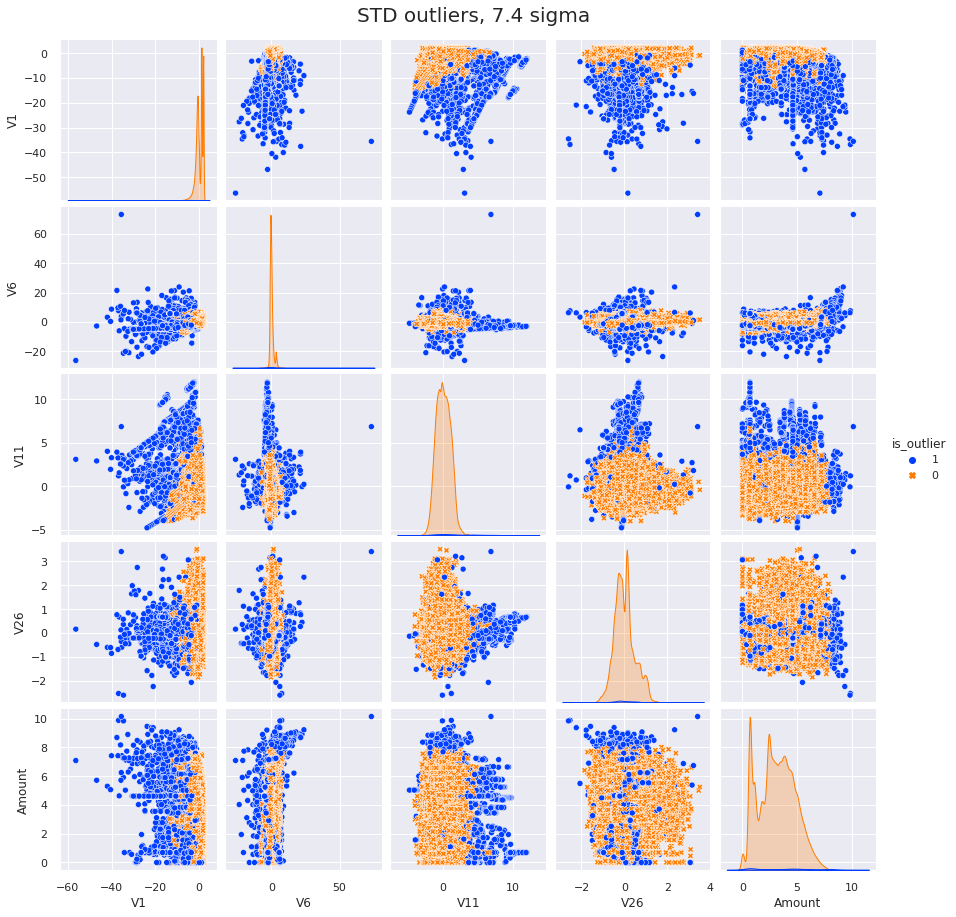

In [33]:
pairplot_with_ouliers(data_features, std_outliers,
                      title=f"STD outliers, {threshold_std} sigma")

#### Interquartile range

In [34]:
threshold_iqr = 10.4

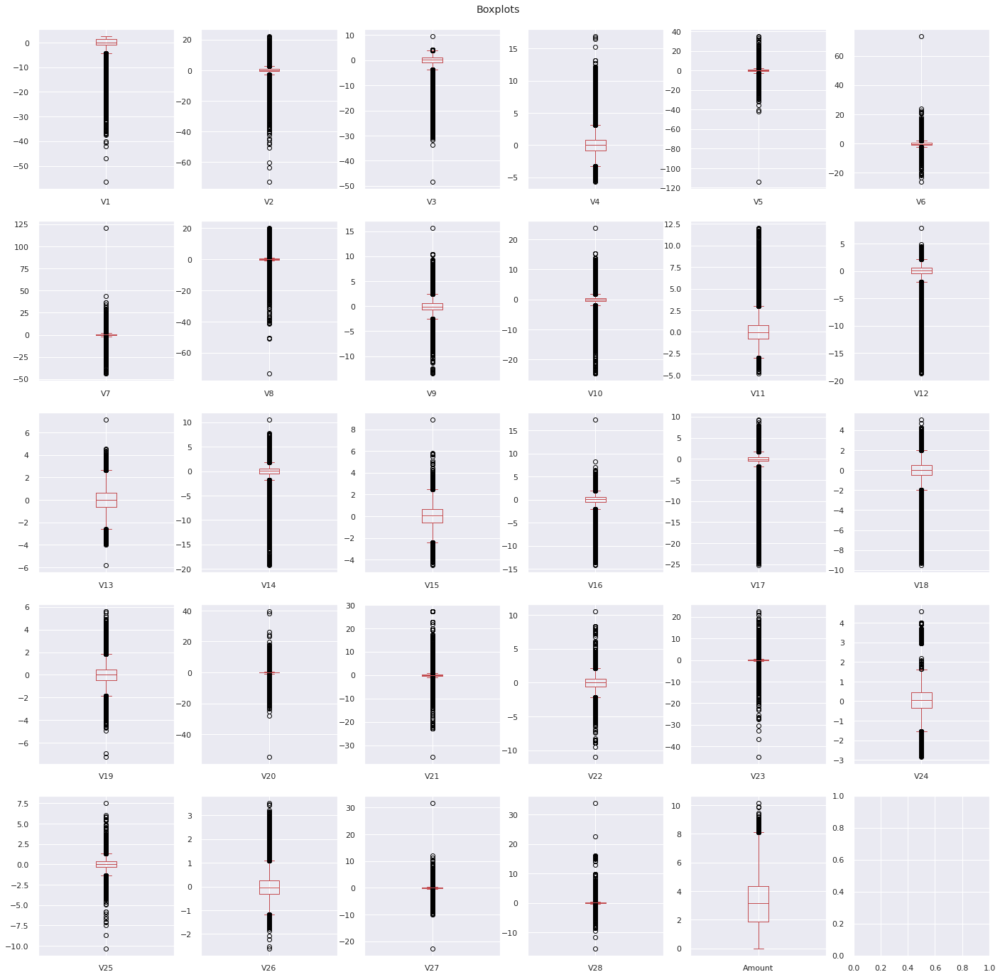

In [35]:
n_features = data_features.shape[1]
fig, axes = plt.subplots(5, n_features//5+1, figsize=(24, 24))
fig.suptitle('Boxplots', y= 0.9)

row = 0
col = 0

for ax, feature in enumerate(data_features):
    data_features[feature].plot.box(ax=axes[row, col], color="r")
    col += 1
    if col > 5:
        row += 1
        col = 0

In [36]:
def outlier_iqr(data, col, threshold=threshold_iqr):
    IQR = data[col].quantile(0.75) - data[col].quantile(0.25)
    up_bound = data[col].quantile(0.75) + (IQR * threshold)
    low_bound = data[col].quantile(0.25) - (IQR * threshold)
    anomalies = pd.concat(
        [data[col] > up_bound, data[col] < low_bound], axis=1).any(1)
    return anomalies, up_bound, low_bound

In [37]:
comparison_table, iqr_outliers = get_column_outliers(
    data_features, function=outlier_iqr, threshold=threshold_iqr)
anomalies_report(iqr_outliers)

Total number of outliers: 7336
Percentage of outliers:   2.56%


#####  Quality check - IQR

Confusion matrix:

[[277930   6090]
 [  1383   1246]]


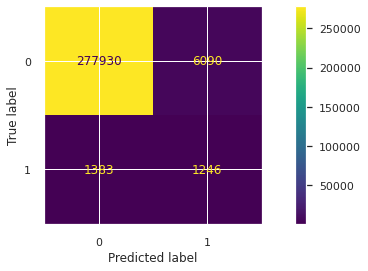


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.98      0.99    284020
         1.0       0.17      0.47      0.25      2629

    accuracy                           0.97    286649
   macro avg       0.58      0.73      0.62    286649
weighted avg       0.99      0.97      0.98    286649



In [38]:
quality_check(data["Class"], iqr_outliers, "iqr")

In [39]:
comparison_table

,upper_bound,lower_bound,anomalies_count,anomalies_percentage
V27,1.7991,-1.7765,2621.0,0.9144
V8,5.9541,-5.8298,2218.0,0.7738
V20,3.7493,-3.8247,1646.0,0.5742
V28,1.4579,-1.4313,1588.0,0.5540
V21,4.5341,-4.5722,1341.0,0.4678
V23,3.3762,-3.3908,1268.0,0.4424
V17,9.6364,-9.7308,909.0,0.3171
V7,12.3318,-12.3310,670.0,0.2337
V14,10.1319,-10.0803,627.0,0.2187
V10,10.7729,-10.8712,607.0,0.2118


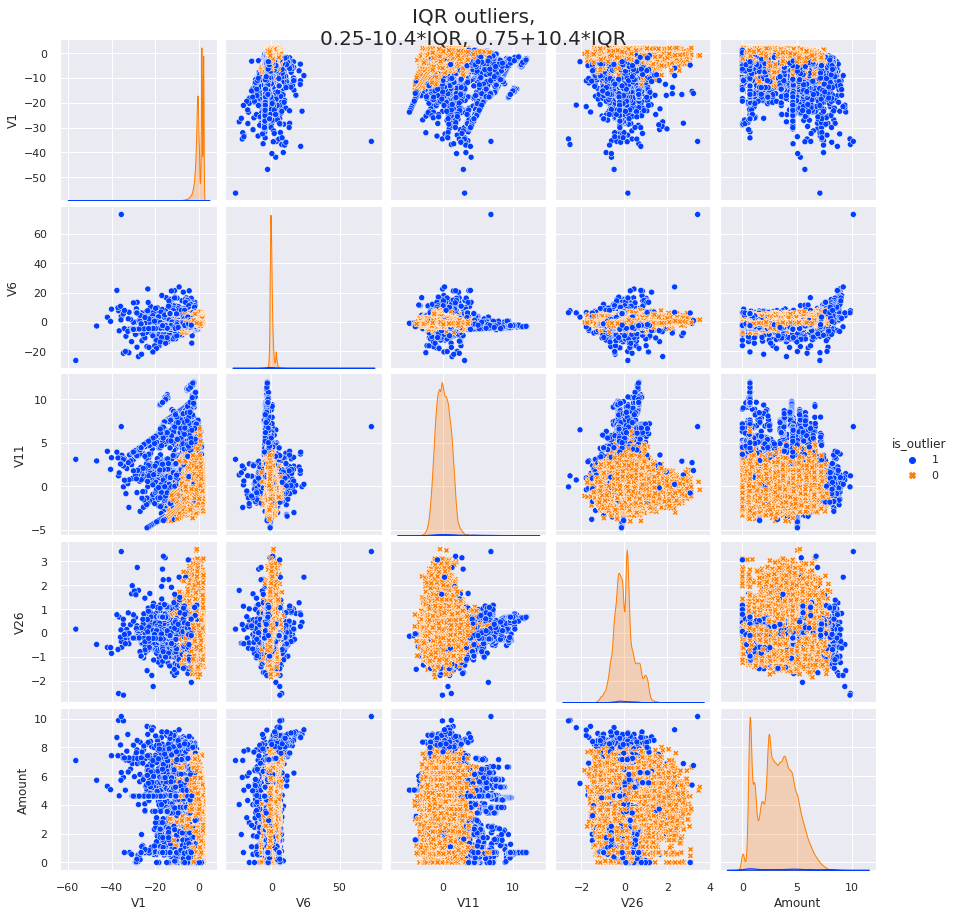

In [40]:
pairplot_with_ouliers(data_features, std_outliers,
                      title=f"IQR outliers,\n0.25-{threshold_iqr}*IQR, 0.75+{threshold_iqr}*IQR")

#### Clustering

In [41]:
class DistanceOutliers(BaseEstimator):
    """
    -----------
    Parameters:

    - metric: string, default - euclidean
        metric to use for distance calculation (see scipy.spatial.distance.cdist)

    - percentile: float in range [0, 100]
        hyperparameter which sets the threshold for anomalies
    """

    def __init__(self, metric='euclidean', percentile=90):
        self.metric = metric
        self.percentile = percentile

    def fit(self, X):
        self.centroid = np.mean(X, axis=0).values.reshape(-1, 1).T
        distances_train = cdist(
            self.centroid, X, metric=self.metric).reshape(-1)
        self.threshold = np.percentile(distances_train, self.percentile)

    def predict(self, X):
        distances = cdist(self.centroid, X, metric=self.metric).reshape(-1)
        predictions = (distances > self.threshold).astype(int)
        return predictions

#####  Euclidean distance

In [42]:
euclidian_model = DistanceOutliers(metric='euclidean', percentile=98.7)
euclidian_model.fit(scaled_data)
euclidian_outliers = euclidian_model.predict(scaled_data)
anomalies_report(euclidian_outliers)
labeled_data = data_features.copy()
labeled_data['is_outlier'] = euclidian_outliers

Total number of outliers: 3727
Percentage of outliers:   1.30%


###### Quality check - Euclidian distance

Confusion matrix:

[[281678   2342]
 [  1244   1385]]


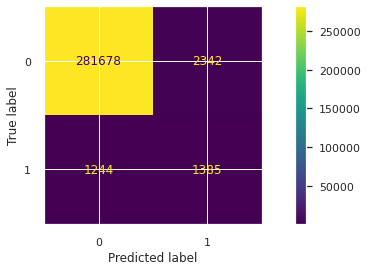


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.99      0.99    284020
         1.0       0.37      0.53      0.44      2629

    accuracy                           0.99    286649
   macro avg       0.68      0.76      0.71    286649
weighted avg       0.99      0.99      0.99    286649



In [43]:
quality_check(data["Class"], euclidian_outliers, "euclid")

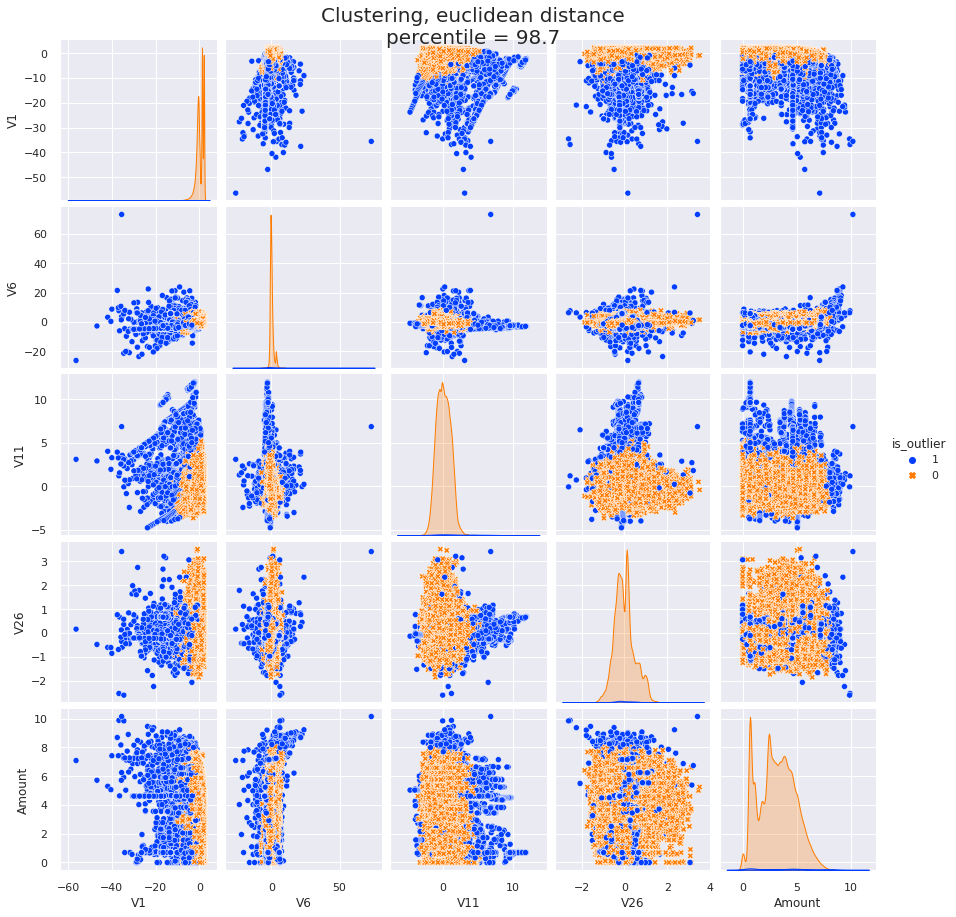

In [44]:
pairplot_with_ouliers(data, euclidian_outliers,
                      title=f"Clustering, euclidean distance\npercentile = 98.7")

##### Cityblock distance

In [45]:
cityblock_model = DistanceOutliers(metric='cityblock', percentile=98.7)
cityblock_model.fit(scaled_data)
cityblock_outliers = cityblock_model.predict(scaled_data)
anomalies_report(cityblock_outliers)

labeled_data = data_features.copy()
labeled_data['is_outlier'] = cityblock_outliers

Total number of outliers: 3727
Percentage of outliers:   1.30%


###### Quality check - Cityblock distance

Confusion matrix:

[[281790   2230]
 [  1132   1497]]


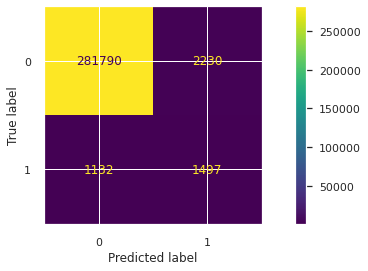


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.99      0.99    284020
         1.0       0.40      0.57      0.47      2629

    accuracy                           0.99    286649
   macro avg       0.70      0.78      0.73    286649
weighted avg       0.99      0.99      0.99    286649



In [46]:
quality_check(data["Class"], cityblock_outliers, "cityblock")

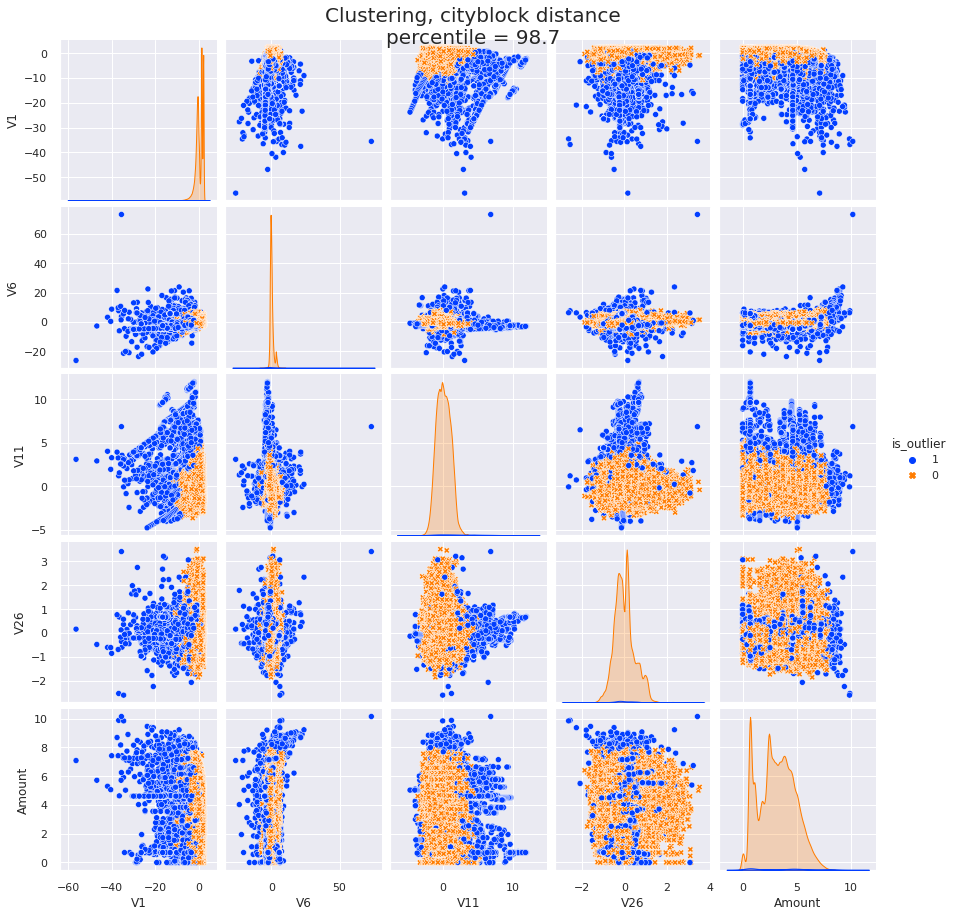

In [47]:
pairplot_with_ouliers(data, cityblock_outliers,
                      title=f"Clustering, cityblock distance\npercentile = 98.7")

### Density-based

#### DBSCAN

In [48]:
%%script false --no-raise-error

# Set all recodes as inliers
outlier_percentage = 1.0

num_clusters = []
anomaly_percentage = []

# Begin with an eps value from the beginning of distances tail and then start increasing it
eps = 5.0
eps_history = [eps]
while outlier_percentage > 0.01:#0.00173:
    model = DBSCAN(eps=eps, min_samples=15, n_jobs=n_jobs).fit(scaled_data)
    labels = model.labels_
    num_clusters.append(len(np.unique(labels))-1)
    labels = np.array([1 if label == -1 else 0 for label in labels])
    # Calculate anomalies percentage
    outlier_percentage = sum(labels == 1) / len(labels)
    eps += 1
    eps_history.append(eps)
    anomaly_percentage.append(outlier_percentage)
    print(anomaly_percentage[-1])

model = DBSCAN(eps, min_samples=15, n_jobs=n_jobs)
model.fit(scaled_data)
density_outliers = np.array(
    [1 if label == -1 else 0 for label in model.labels_])

In [49]:
%%script false --no-raise-error

anomalies_report(density_outliers)

In [50]:
%%script false --no-raise-error

iterations = eps_history[:-1]

fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('eps')
ax1.set_ylabel('number of clusters', color=color)
ax1.plot(iterations, num_clusters, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()

color = 'tab:blue'
ax2.set_ylabel('anomaly percentage', color=color)
ax2.plot(iterations, anomaly_percentage, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()
plt.show()

##### Quality check - DBSCAN

In [51]:
%%script false --no-raise-error

quality_check(data["Class"], density_outliers, "dbscan")

In [52]:
%%script false --no-raise-error

labeled_data = data_features.copy()
labeled_data['is_outlier'] = density_outliers

pairplot_with_ouliers(labeled_data, labeled_data['is_outlier'],
                      title="DBSCAN")

## Unsupervised model-based

### One-Class SVM

In [53]:
one_class_svm = OneClassSVM(nu=0.03, gamma="auto") 
one_class_svm.fit(scaled_data)
svm_outliers = one_class_svm.predict(scaled_data)
svm_outliers = np.array([1 if label == -1 else 0 for label in svm_outliers])

In [54]:
anomalies_report(svm_outliers)

Total number of outliers: 8593
Percentage of outliers:   3.00%


#### Quality check - OneClassSVM

Confusion matrix:

[[277027   6993]
 [  1029   1600]]


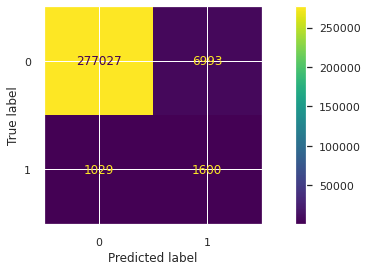


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.98      0.99    284020
         1.0       0.19      0.61      0.29      2629

    accuracy                           0.97    286649
   macro avg       0.59      0.79      0.64    286649
weighted avg       0.99      0.97      0.98    286649



In [55]:
quality_check(data["Class"], svm_outliers, "svm")

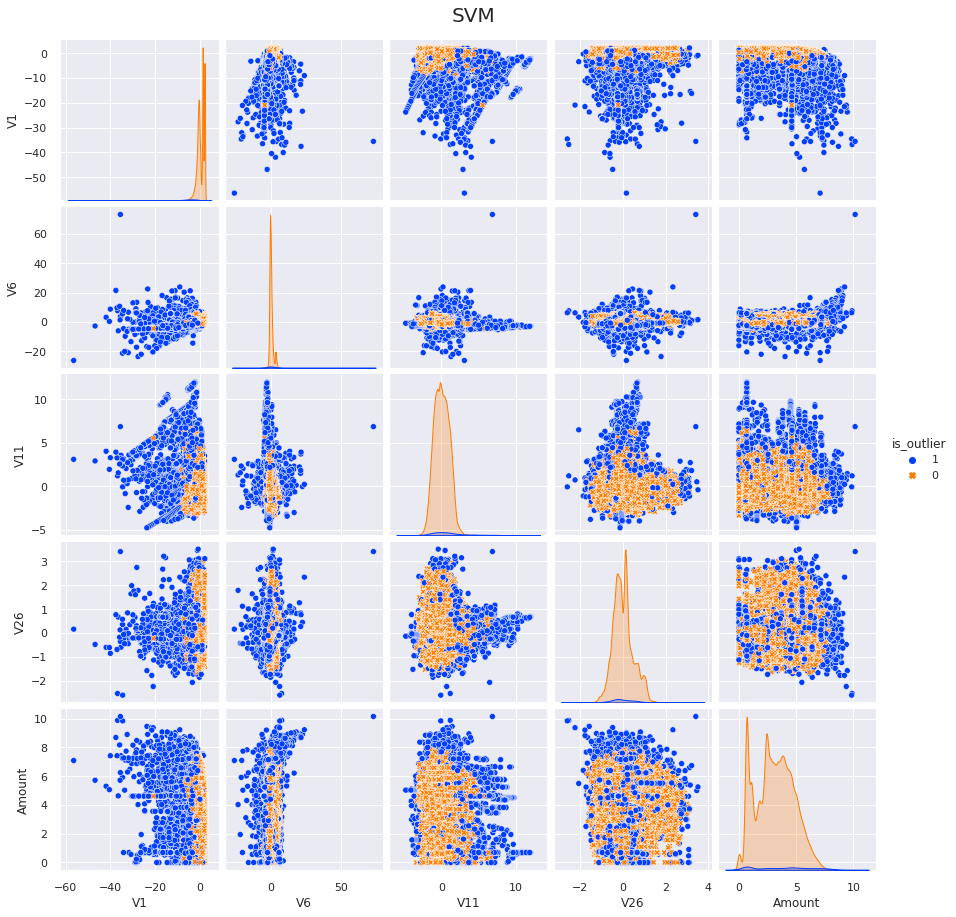

In [56]:
labeled_data = data_features.copy()
labeled_data['is_outlier'] = svm_outliers

pairplot_with_ouliers(labeled_data, labeled_data['is_outlier'],
                      title="SVM")

### Isolation Forest

In [57]:
isolation_forest = IsolationForest(n_estimators=300, contamination=0.01, 
                                   max_features=1.0, bootstrap=True, 
                                   random_state=random_state)
isolation_forest.fit(scaled_data)

isolation_outliers = isolation_forest.predict(scaled_data)
isolation_outliers = np.array(
    [1 if label == -1 else 0 for label in isolation_outliers])

In [58]:
anomalies_report(isolation_outliers)

Total number of outliers: 2867
Percentage of outliers:   1.00%


#### Quality check - iForest

Confusion matrix:

[[282532   1488]
 [  1250   1379]]


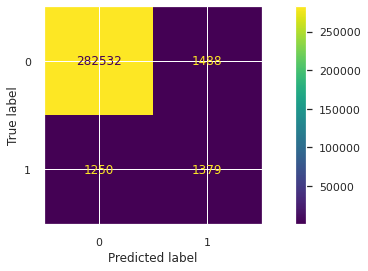


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00    284020
         1.0       0.48      0.52      0.50      2629

    accuracy                           0.99    286649
   macro avg       0.74      0.76      0.75    286649
weighted avg       0.99      0.99      0.99    286649



In [59]:
quality_check(data["Class"], isolation_outliers,"isolation")

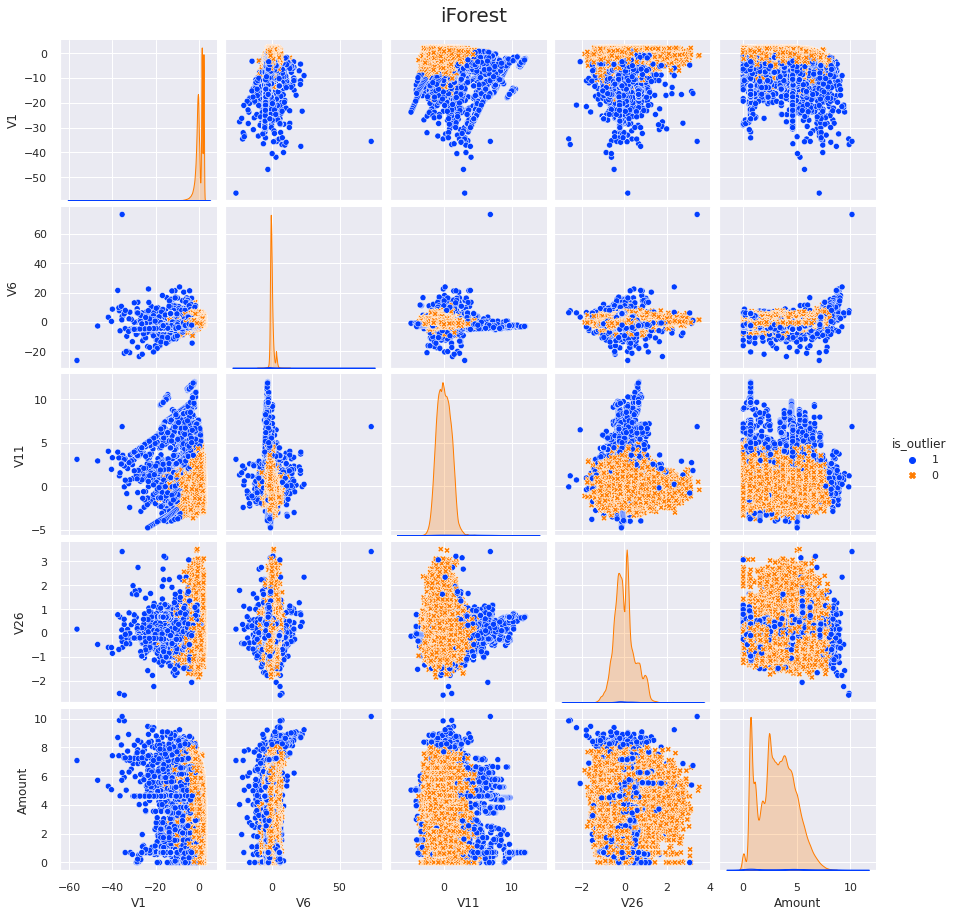

In [60]:
labeled_data = data_features.copy()
labeled_data['is_outlier'] = isolation_outliers

pairplot_with_ouliers(data, isolation_outliers,
                      title="iForest")

In [61]:
visualize_3d(labeled_data, labeled_data['is_outlier'],
             title="Clustering with isolation forest")

## Methods comparison

In [62]:
summary_ = np.concatenate((
    [std_outliers],
    [iqr_outliers],
    [euclidian_outliers],
    [cityblock_outliers],
#     [density_outliers],
    [svm_outliers],
    [isolation_outliers]
))

In [63]:
summary = pd.DataFrame(
    summary_.T,
    columns=['std', 'iqr', 'euclid', 'cityblock', 'svm', 'isolation'] #'dbscan',
)
summary.tail()

,std,iqr,euclid,cityblock,svm,isolation
286644,0,0,0,0,0,0
286645,0,0,0,0,0,0
286646,0,0,0,0,1,0
286647,1,1,1,1,1,1
286648,1,1,1,1,1,1


In [64]:
summary.sum(axis=1).value_counts()

0    276118
1      4194
6      2176
2      1839
5       964
3       779
4       579
dtype: int64

Mean outliers score for the dataset: 0.017676089340389372


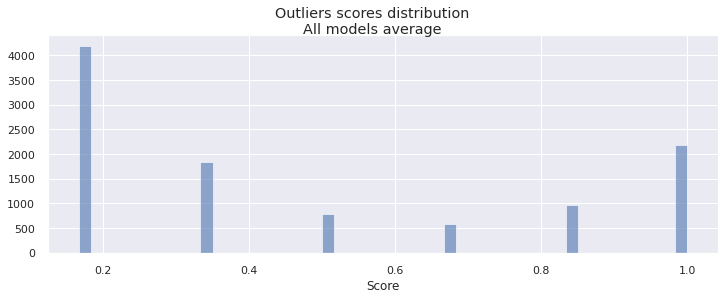

In [65]:
outliers_score = summary.mean(axis=1)
all_non_zero = outliers_score[outliers_score > 0]
_ = plt.hist(all_non_zero, bins=50, alpha=0.6)
plt.suptitle("Outliers scores distribution\nAll models average")
plt.xlabel("Score")
print(f"Mean outliers score for the dataset: {outliers_score.apply('mean')}")

### All combined (average score)

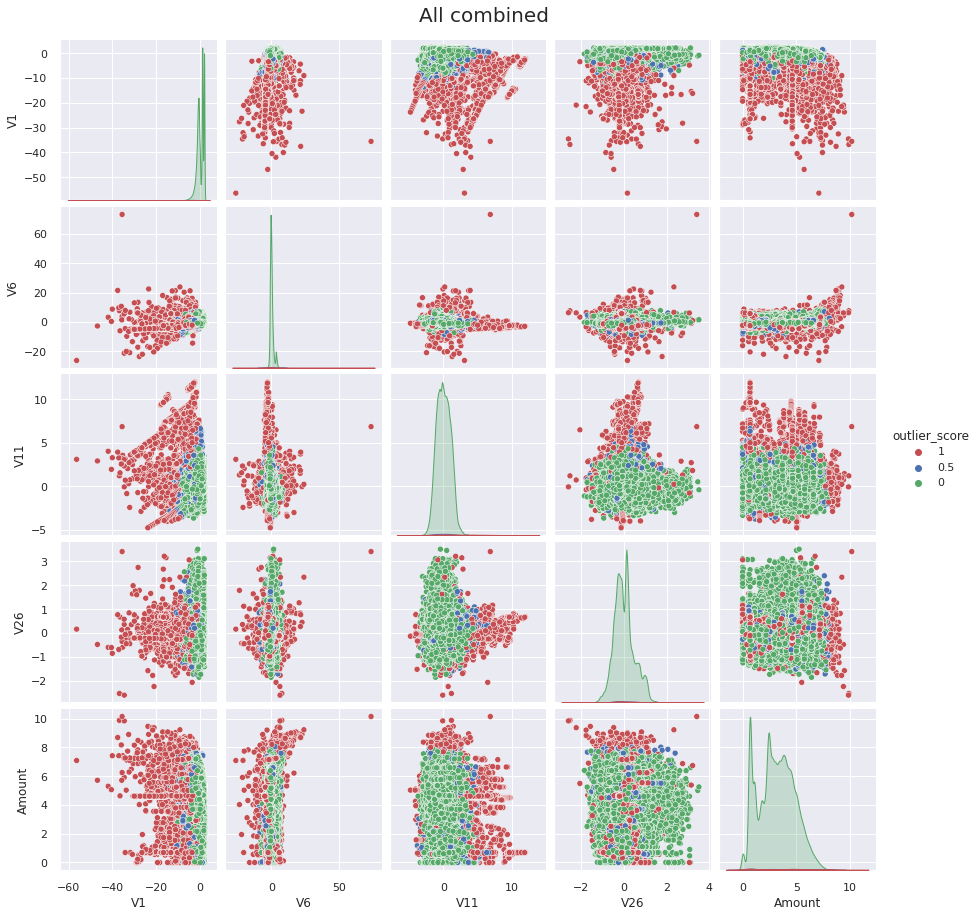

In [66]:
simple_score = outliers_score.apply(
    lambda x: 0 if x < 0.2 else 0.5 if x < 0.8 else 1)

labeled_data = data_features.copy()
labeled_data['outlier_score'] = simple_score

custom_palette = {0: 'g', 0.5: 'b', 1.0: 'r'}

cols = ['V1', 'V6', 'V11', 'V26', 'Amount']
featured_columns = cols.copy()
cols.append('outlier_score')

_ = sns.pairplot(data=labeled_data[cols],
                 vars=featured_columns, hue='outlier_score',
                 hue_order=[1, 0.5, 0], 
                 palette=custom_palette)
plt.suptitle("All combined", y=1.02, fontsize=20)
plt.show()

#### Quality check - all models average

Confusion matrix:

[[279243   4777]
 [  1069   1560]]


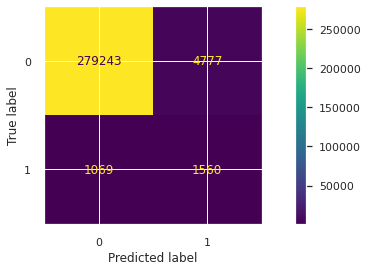


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.98      0.99    284020
         1.0       0.25      0.59      0.35      2629

    accuracy                           0.98    286649
   macro avg       0.62      0.79      0.67    286649
weighted avg       0.99      0.98      0.98    286649



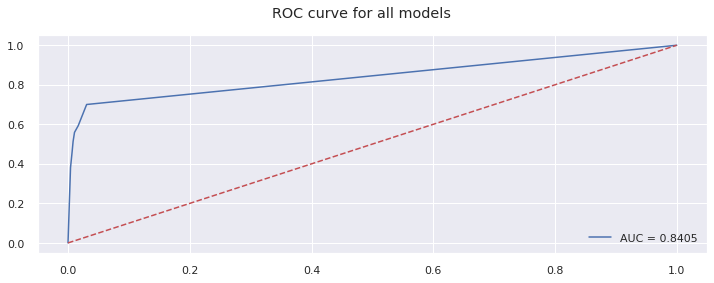

In [67]:
final_score = np.array([1 if outliers_score.iloc[s] > 0.2 else 0 for s in outliers_score.index])
quality_check(data["Class"], final_score, "all_models")
# ROC_AUC
fpr, tpr, _ = roc_curve(data["Class"], outliers_score)
auc = roc_auc_score(data["Class"],  outliers_score)
plt.plot(fpr, tpr, label=f"AUC = {str(round(auc,4))}")
plt.plot([0, 1], [0, 1],'r--')
plt.suptitle("ROC curve for all models")
plt.legend(loc=4)
plt.show()

In [68]:
visualize_3d(labeled_data, final_score,
             title="All models average")

### Only model-based

Mean outliers score for the dataset: 0.0400


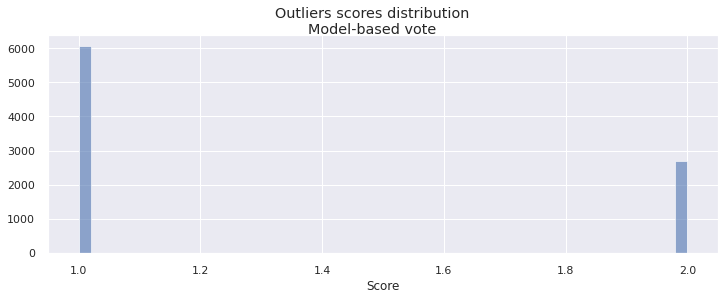

In [69]:
outliers_score_model_based = np.array(summary[[
            "svm", "isolation"]].sum(axis=1))#'dbscan', 
all_non_zero = outliers_score_model_based[outliers_score_model_based > 0]
_ = plt.hist(all_non_zero, bins=50, alpha=0.6)
plt.suptitle("Outliers scores distribution\nModel-based vote")
plt.xlabel("Score")
print(f"Mean outliers score for the dataset: {np.mean(outliers_score_model_based):.4f}")

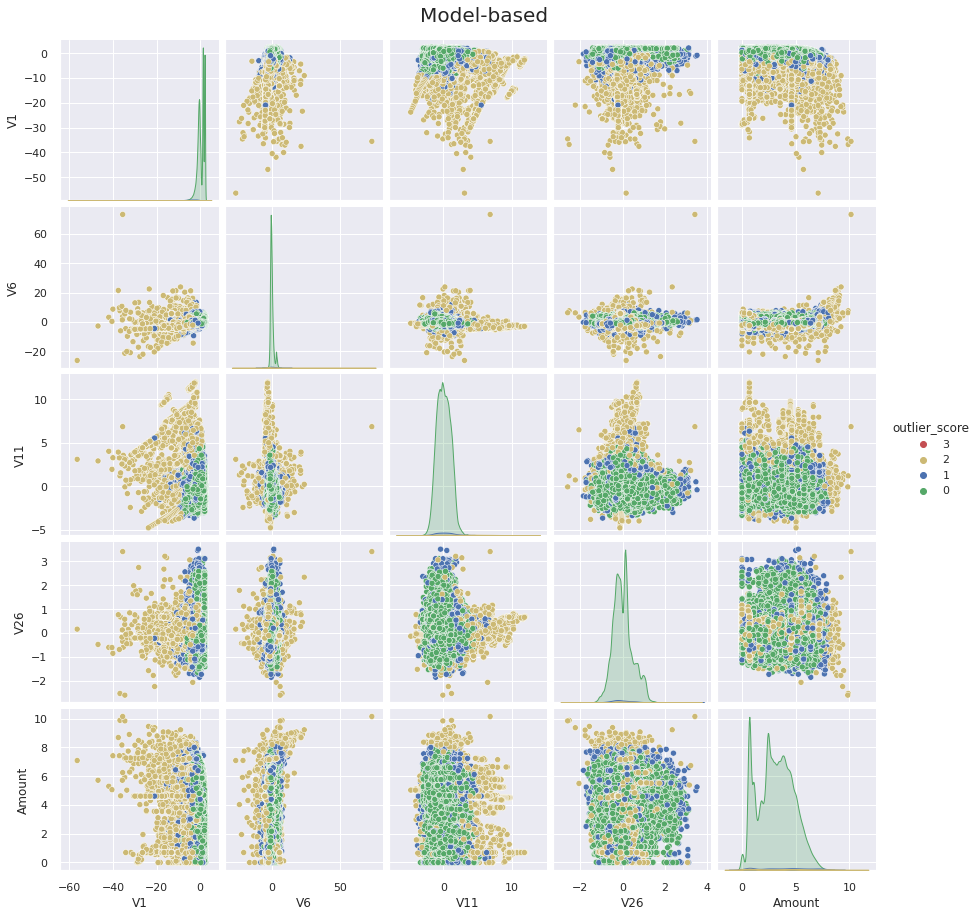

In [70]:
labeled_data = data_features.copy()
labeled_data['outlier_score'] = outliers_score_model_based

custom_palette = {0: 'g', 1: 'b', 2: 'y', 3: 'r'}

cols = ['V1', 'V6', 'V11', 'V26', 'Amount']
featured_columns = cols.copy()
cols.append('outlier_score')

_ = sns.pairplot(data=labeled_data[cols],
                 vars=featured_columns, hue='outlier_score',
                 hue_order=[3, 2, 1, 0], 
                 palette=custom_palette)
plt.suptitle("Model-based", y=1.02, fontsize=20)
plt.show()

#### Quality check - model-based

Confusion matrix:

[[277020   7000]
 [   861   1768]]


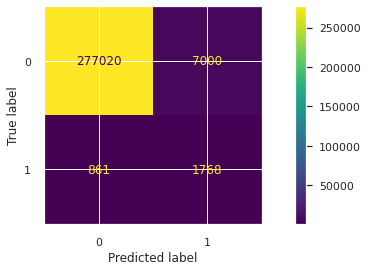


-----------------------------------------------------

Classification report:

              precision    recall  f1-score   support

         0.0       1.00      0.98      0.99    284020
         1.0       0.20      0.67      0.31      2629

    accuracy                           0.97    286649
   macro avg       0.60      0.82      0.65    286649
weighted avg       0.99      0.97      0.98    286649



In [71]:
final_score_model_based = [1 if outliers_score_model_based[s] > 0.5 else 0 for s in range(outliers_score_model_based.size)]
quality_check(data["Class"], final_score_model_based, "model-based")

In [72]:
visualize_3d(labeled_data, np.array(final_score_model_based),
             title="Model-based vote")

## Comparison of results - classification reports

In [73]:
def classif_reports(crs_dict):
    """
    Argument:
    dictionary {name: classification report}
    
    Returns:
    dataframe with all classification reports
    """
    results = pd.DataFrame.from_dict(crs_dict)
    df_temp=pd.DataFrame(np.diag(results), index=[results.columns, results.index])
    df_temp.index = df_temp.index.droplevel(1)
    df = df_temp.T
    subcols = ["", "precision", "recall", "f1-score", "support"]
    lvl1 = [list(k.keys())[0] for k in crs_dict]
    mc = pd.DataFrame(columns=pd.MultiIndex.from_product([lvl1, subcols]))
    
    for c in list(mc.columns.levels)[0]:
        lst = df.loc[0, c].split()
        lst = lst[4:]
        lst[13] = lst[13] + " " + lst[14]
        lst.pop(14)
        lst[18] = lst[18] + " " + lst[19]
        lst.pop(19)
        lst.insert(11,"")
        lst.insert(12,"")
        for r in range(5):
            mc.loc[r, c] = lst[r*len(lst)//5:r*len(lst)//5+5]
    return mc

report = classif_reports(crs)
report

std                                             iqr            \
                precision recall f1-score support               precision   
0           0.0      1.00   0.99     0.99  284020           0.0      1.00   
1           1.0      0.32   0.51     0.39    2629           1.0      0.17   
2      accuracy                      0.99  286649      accuracy             
3     macro avg      0.66   0.75     0.69  286649     macro avg      0.58   
4  weighted avg      0.99   0.99     0.99  286649  weighted avg      0.99   

                                 euclid                                    \
  recall f1-score support               precision recall f1-score support   
0   0.98     0.99  284020           0.0      1.00   0.99     0.99  284020   
1   0.47     0.25    2629           1.0      0.37   0.53     0.44    2629   
2            0.97  286649      accuracy                      0.99  286649   
3   0.73     0.62  286649     macro avg      0.68   0.76     0.71  286649   
4   0.97     0.98  286649  weighted avg      0.99   0.99     0.99  286649   

      cityblock                                             svm            \
                precision recall f1-score support               precision   
0           0.0      1.00   0.99     0.99  284020           0.0      1.00   
1           1.0      0.40   0.57     0.47    2629           1.0      0.19   
2      accuracy                      0.99  286649      accuracy             
3     macro avg      0.70   0.78     0.73  286649     macro avg      0.59   
4  weighted avg      0.99   0.99     0.99  286649  weighted avg      0.99   

                              isolation                                    \
  recall f1-score support               precision recall f1-score support   
0   0.98     0.99  284020           0.0      1.00   0.99     1.00  284020   
1   0.61     0.29    2629           1.0      0.48   0.52     0.50    2629   
2            0.97  286649      accuracy                      0.99  286649   
3   0.79     0.64  286649     macro avg      0.74   0.76     0.75  286649   
4   0.97     0.98  286649  weighted avg      0.99   0.99     0.99  286649   

     all_models                                     model-based            \
                precision recall f1-score support               precision   
0           0.0      1.00   0.98     0.99  284020           0.0      1.00   
1           1.0      0.25   0.59     0.35    2629           1.0      0.20   
2      accuracy                      0.98  286649      accuracy             
3     macro avg      0.62   0.79     0.67  286649     macro avg      0.60   
4  weighted avg      0.99   0.98     0.98  286649  weighted avg      0.99   

                           
  recall f1-score support  
0   0.98     0.99  284020  
1   0.67     0.31    2629  
2            0.97  286649  
3   0.82     0.65  286649  
4   0.97     0.98  286649

<div class="alert alert-block alert-success">
<b>And the winners are:</b> Cityblock distance and isolation forest algorithms. Multi-model approaches do not improve the relatively modest performance of their constituents.  
Decent F1 scores are achieved by increasing recall at the expense of precision - this is a possible explanation of the fact that banks block so many innocent card transactions.
</div>